# Pokemon Generation using GANs

## Imports

Here we import all the needed libraries for the project.
We also set a seed for pytorch to handle reproductability.

In [0]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from PIL import Image

manualSeed = 999 # Use 'random.randint(1, 10000)' to deactivate reproductability
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


## Connect to drive

In order to use pokemon data you need to get data from [this Github project](https://github.com/rileynwong/pokemon-images-dataset-by-type).\
Then you need to convert them to `.png` and save them in a file nammed `data` in your Google Drive.\
**Do not forget to change the `prefix` variable to the path to your data.**

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')
prefix = "gdrive/My Drive/ECP/DL"

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


## Project parameters

Define the global variables here. **You should write them in upper case.**
**If you change `IMAGE_SIZE` you'll need to update the models to handle a new image size!**

In [0]:
### DATA
DATAROOT = os.path.join(prefix, "data") # Root directory for dataset
NUM_CHANNELS = 3 # Number of channels in the training images.
RESCALE_SIZE = 300 # Size to rescale the images before random crop
IMAGE_SIZE = 256 # Size of the random crop. Final size of the image
WORKERS = 2 # Number of workers for dataloader

### NETWORKS
LATENT_SIZE = 100 # Size of z latent vector
G_FEATURE_SIZE = 64 # Size of feature maps in generator
D_FEATURE_SIZE = 64 # Size of feature maps in discriminator

### TRAINING
BATCH_SIZE = 16 # Batch size during training
NUM_EPOCHS = 1000 # Number of training epochs
LEARNING_RATE = 0.00005 # Learning rate for optimizers
G_BETA_1 = 0.5 # Beta1 hyperparam for generator Adam optimizer
D_BETA_1 = 0.5 # Beta1 hyperparam for discriminator Adam optimizer

### DEVICE
NGPU = 1 # Number of GPUs available. Use 0 for CPU mode.

## Data preparation

We use a `torch.utils.data.DataLoader` to handle the data. That way we can easily apply random transformation to each batch at every epoch.

In [0]:
# Create the dataset
dataset = dset.ImageFolder(root=DATAROOT,
                           transform=transforms.Compose([
                               transforms.Resize(RESCALE_SIZE),
                               transforms.RandomCrop(IMAGE_SIZE),
                               transforms.RandomHorizontalFlip(),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE,
                                         shuffle=True, num_workers=WORKERS)



We test if we can use a GPU with cuda and we accordingly select the device.

In [0]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and NGPU > 0) else "cpu")
print(device)

cuda:0


Here is a sample of the preprocessed data used for the training.

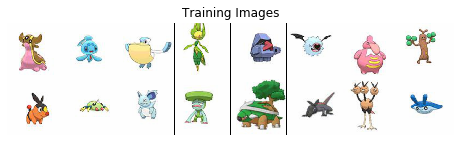

In [0]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:32], padding=2, normalize=True).cpu(),(1,2,0)))

## Models definition

In [0]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [0]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, NGPU):
        super(Generator, self).__init__()
        self.ngpu = NGPU
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(LATENT_SIZE, G_FEATURE_SIZE * 32, 4, 1, 0, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 32),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE * 32) x 4 x 4
            nn.ConvTranspose2d(G_FEATURE_SIZE * 32, G_FEATURE_SIZE * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 16),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE * 16) x 8 x 8
            nn.ConvTranspose2d(G_FEATURE_SIZE * 16, G_FEATURE_SIZE * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 8),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE * 8) x 16 x 16
            nn.ConvTranspose2d(G_FEATURE_SIZE * 8, G_FEATURE_SIZE * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 4),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE * 4) x 32 x 32
            nn.ConvTranspose2d(G_FEATURE_SIZE * 4, G_FEATURE_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 2),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE * 2) x 64 x 64
            nn.ConvTranspose2d(G_FEATURE_SIZE * 2, G_FEATURE_SIZE, 4, 2, 1, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE),
            nn.ReLU(True),
            # state size. (G_FEATURE_SIZE) x 128 x 128
            nn.ConvTranspose2d(G_FEATURE_SIZE, NUM_CHANNELS, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (NUM_CHANNELS) x 256 x 256
        )

    def forward(self, input):
        return self.main(input)

In [0]:
# Discriminator code
class Discriminator(nn.Module):
    def __init__(self, NGPU):
        super(Discriminator, self).__init__()
        self.ngpu = NGPU
        self.main = nn.Sequential(
            # input is (NUM_CHANNELS) x 256 x 256
            nn.Conv2d(NUM_CHANNELS, D_FEATURE_SIZE, 6, 4, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (D_FEATURE_SIZE) x 64 x 64
            nn.Conv2d(D_FEATURE_SIZE, D_FEATURE_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(D_FEATURE_SIZE * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (D_FEATURE_SIZE * 2) x 32 x 32
            nn.Conv2d(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(D_FEATURE_SIZE * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (D_FEATURE_SIZE * 2) x 16 x 16
            nn.Conv2d(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(D_FEATURE_SIZE * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (D_FEATURE_SIZE * 2) x 8 x 8
            nn.Conv2d(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(D_FEATURE_SIZE * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (D_FEATURE_SIZE * 2) x 4 x 4
            nn.Conv2d(D_FEATURE_SIZE * 2, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

## Training

In [0]:
# Create the generator
netG = Generator(NGPU).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (NGPU > 1):
    netG = nn.DataParallel(netG, list(range(NGPU)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 2048, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Ba

In [0]:
# Create the Discriminator
netD = Discriminator(NGPU).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (NGPU > 1):
    netD = nn.DataParallel(netD, list(range(NGPU)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(6, 6), stride=(4, 4), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(128, eps=1e-05, 

In [0]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, LATENT_SIZE, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=LEARNING_RATE, betas=(D_BETA_1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=LEARNING_RATE, betas=(G_BETA_1, 0.999))

In [0]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
D_xs = []
D_G_z = []

print("Starting Training Loop...")
# For each epoch
for epoch in range(NUM_EPOCHS):
  # For each batch in the dataloader
  for i, data in enumerate(dataloader, 0):

    # Format batch
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    labels_real = torch.full((b_size,), real_label, device=device)
    labels_fake = torch.full((b_size,), fake_label, device=device)
    ############################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    ## Train with all-real batch
    netD.zero_grad()
    
    # Forward pass real batch through D
    outputD_real = netD(real_cpu).view(-1)
    # Calculate loss on all-real batch
    errD_real = criterion(outputD_real, labels_real)
    # Calculate gradients for D in backward pass
    D_x = outputD_real.mean().item()

    ## Train with all-fake batch
    # Generate batch of latent vectors
    noise = torch.randn(b_size, LATENT_SIZE, 1, 1, device=device)
    # Generate fake image batch with G
    fake = netG(noise)
    # Classify all fake batch with D
    outputD_fake = netD(fake.detach()).view(-1)
    # Calculate D's loss on the all-fake batch
    errD_fake = criterion(outputD_fake, labels_fake)
    # Calculate the gradients for this batch
    D_G_z1 = outputD_fake.mean().item()
    # Add the gradients from the all-real and all-fake batches
    errD = errD_real + errD_fake
    # Update D
    errD.backward()
    optimizerD.step()

    ############################
    # (2) Update G network: maximize log(D(G(z)))
    ###########################
    netG.zero_grad()
    # Since we just updated D, perform another forward pass of all-fake batch through D
    outputG = netD(fake).view(-1)
    # Calculate G's loss based on this output
    errG = criterion(outputG, labels_real)
    # Calculate gradients for G
    errG.backward()
    D_G_z2 = outputG.mean().item()
    # Update G
    optimizerG.step()

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Save minmax params
    D_xs.append(D_x)
    D_G_z.append(D_G_z2)

  #  Output training stats
  print('[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f' % (epoch+1, NUM_EPOCHS, errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

  # Check how the generator is doing by saving G's output on fixed_noise
  if (epoch % (NUM_EPOCHS / 50) == 0) or ((epoch == NUM_EPOCHS - 1) and (i == len(dataloader) - 1)):
    with torch.no_grad():
      fake = netG(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

Starting Training Loop...
[1/1000]	Loss_D: 2.2284	Loss_G: 0.5509	D(x): 0.7584	D(G(z)): 0.8399 / 0.5884
[2/1000]	Loss_D: 2.6784	Loss_G: 0.6385	D(x): 0.7202	D(G(z)): 0.8679 / 0.5298
[3/1000]	Loss_D: 2.4354	Loss_G: 0.9193	D(x): 0.5169	D(G(z)): 0.7900 / 0.4118
[4/1000]	Loss_D: 0.9317	Loss_G: 1.7014	D(x): 0.8930	D(G(z)): 0.5545 / 0.1848
[5/1000]	Loss_D: 0.7825	Loss_G: 1.7483	D(x): 0.8640	D(G(z)): 0.4433 / 0.1858
[6/1000]	Loss_D: 0.3034	Loss_G: 2.3829	D(x): 0.9641	D(G(z)): 0.2310 / 0.1003
[7/1000]	Loss_D: 0.4156	Loss_G: 2.4457	D(x): 0.8572	D(G(z)): 0.2213 / 0.0873
[8/1000]	Loss_D: 0.1653	Loss_G: 2.6728	D(x): 0.9791	D(G(z)): 0.1340 / 0.0699
[9/1000]	Loss_D: 0.1630	Loss_G: 2.6362	D(x): 0.9889	D(G(z)): 0.1408 / 0.0721
[10/1000]	Loss_D: 0.1193	Loss_G: 2.9611	D(x): 0.9960	D(G(z)): 0.1088 / 0.0520
[11/1000]	Loss_D: 0.0592	Loss_G: 3.3845	D(x): 0.9970	D(G(z)): 0.0546 / 0.0351
[12/1000]	Loss_D: 0.0554	Loss_G: 3.3960	D(x): 0.9948	D(G(z)): 0.0489 / 0.0337
[13/1000]	Loss_D: 0.0202	Loss_G: 4.3805	D(x): 0

## Results

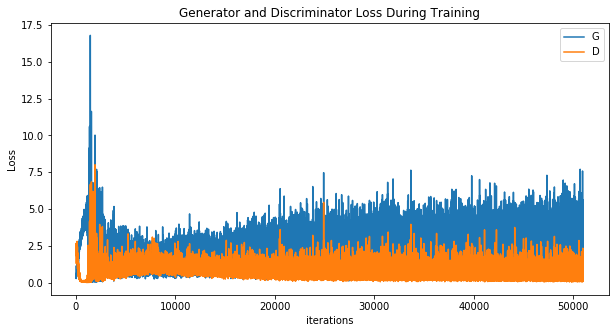

In [0]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

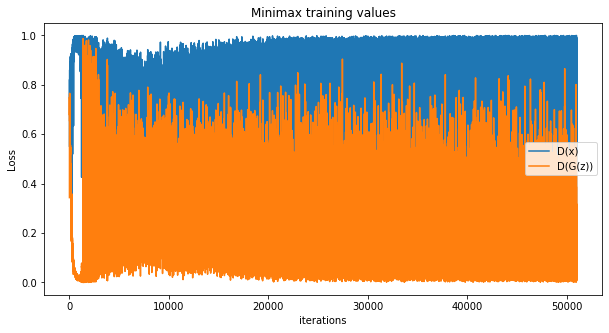

In [0]:
plt.figure(figsize=(10,5))
plt.title("Minimax training values")
plt.plot(D_xs,label="D(x)")
plt.plot(D_G_z,label="D(G(z))")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 20977096 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


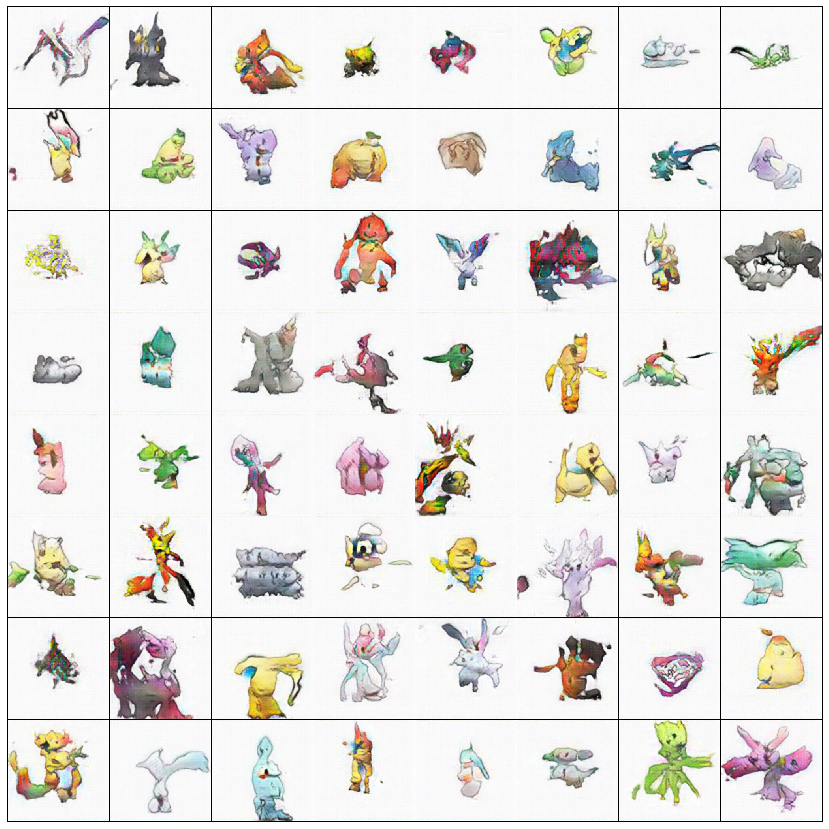

In [0]:
#%%capture
fig = plt.figure(figsize=(15,15))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

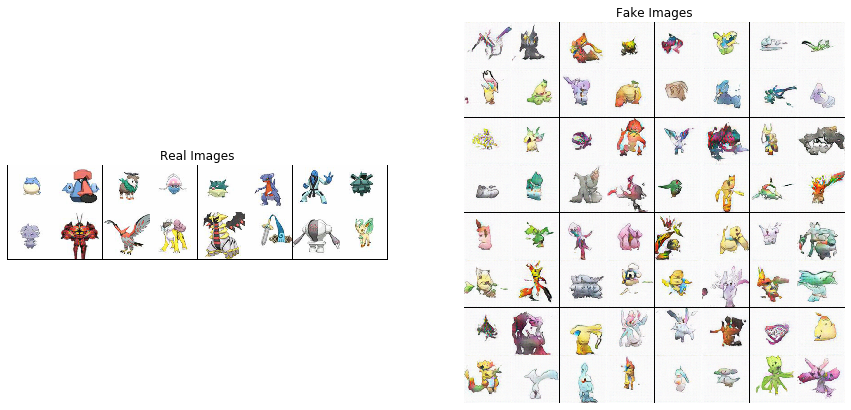

In [0]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

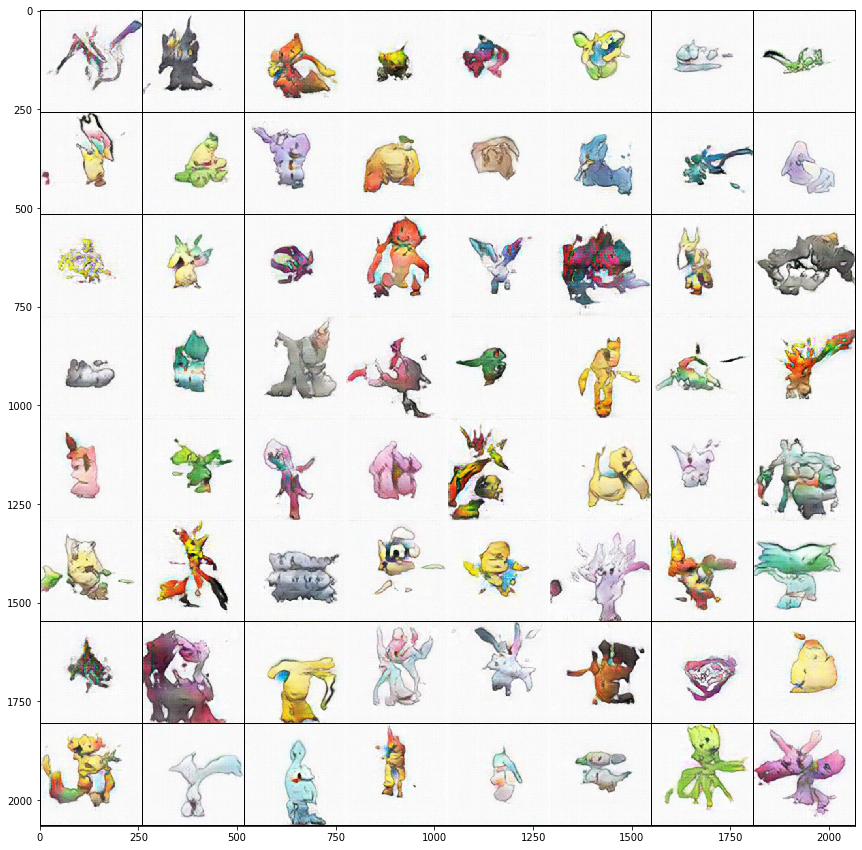

In [0]:
# Save images
plt.figure(figsize=(15,15))
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig(os.path.join(prefix, "wow.png"))

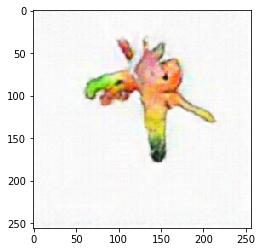

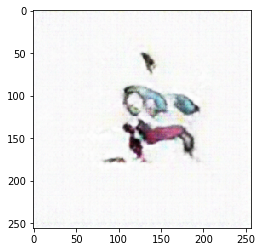

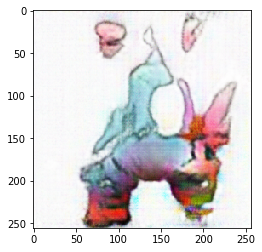

In [0]:
# Generate random pokemons
num_pokemons = 3
latent_vectors = torch.randn(num_pokemons, LATENT_SIZE, 1, 1, device=device)
pokemons = netG(latent_vectors).detach().cpu()

for i in range(num_pokemons):
  plt.figure()
  plt.imshow(np.transpose(vutils.make_grid(pokemons.to(device)[i], padding=5, normalize=True).cpu(),(1,2,0)))